<a href="https://colab.research.google.com/github/Ari-03/DSC_210_Project/blob/main/210Project_image_compression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DSC 210 Project: Linear Algebra in Image Compression

In [1]:
# Standard library imports
import math
import os

# Third-party imports
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from pytorch_msssim import ms_ssim
from scipy.fftpack import dct, idct
import torch
from torchvision import transforms

# Library-specific imports
from compressai.zoo import bmshj2018_factorized, mbt2018

/Users/aritradas/miniforge3/envs/dsc210/lib/python3.10/site-packages/compressai/models/video/google.py:353: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  @amp.autocast(enabled=False)


## Calculates Image Compression Metrics

## Evaluation metric
- Peak Signal-to-Noise Ratio(PSNR)

    Measures the ratio between the maximum possible power of a signal and the power of noise distorting the signal.
    
    **A higher PSNR** indicates that the reconstructed (or compressed) image is closer to the original, meaning **less distortion or error**.

- Multi-Scale Structural Similarity Index (MS-SSIM)
    
    A perceptual metric that compares the structural similarity between two images. Measures luminance, contrast, and structure to better align with human visual perception. 
    
    MS-SSIM values range from 0 to 1. 
    
   ** A value closer to 1** indicates higher similarity to the reference image (**better quality**).

- Bits Per Pixel (BPP)
    
    Measures the compression efficiency by quantifying the number of bits required to store each pixel in the image. 
    
    The **lower BPP** means the **better compression**.


In [2]:
metrics = {}


# Define the PSNR metric function
def compute_psnr(a, b):
    mse = torch.mean((a - b) ** 2).item()
    return -10 * math.log10(mse)


# Define the MS-SSIM metric function
def compute_msssim(a, b):
    return ms_ssim(a, b, data_range=1.0).item()


# Define the BPP metric function for SVD models
def calculate_bpp_svd(image_shape, k, bit_depth=32):
    height, width = image_shape
    num_pixels = height * width

    # Storage requirements for U, S, and V^T for RGB channels
    storage_per_channel = height * k + k + k * width  # U, S, V^T for one channel
    total_storage = (
        3 * storage_per_channel * bit_depth
    )  # Multiply by 3 for RGB and bit depth

    # Calculate BPP
    bpp = total_storage / num_pixels
    return bpp


# Define the BPP metric function for DCT model
def calculate_bpp_dct(img_shape, dct_red, dct_green, dct_blue, bit_depth=8):
    """
    Calculate BPP for an image reconstructed using DCT.
    """
    # Count non-zero coefficients after thresholding
    non_zero_red = np.count_nonzero(dct_red)
    non_zero_green = np.count_nonzero(dct_green)
    non_zero_blue = np.count_nonzero(dct_blue)

    # Total non-zero coefficients
    total_non_zero_coefficients = non_zero_red + non_zero_green + non_zero_blue

    # Total storage in bits
    total_storage_bits = total_non_zero_coefficients * bit_depth

    # Number of pixels in the image
    height, width, _ = img_shape
    num_pixels = height * width

    # Calculate BPP
    bpp = total_storage_bits / num_pixels
    return bpp


# Define the BPP metric function for State of the Art models
def compute_bpp(out_net):
    size = out_net["x_hat"].size()
    num_pixels = size[0] * size[2] * size[3]
    return sum(
        torch.log(likelihoods).sum() / (-math.log(2) * num_pixels)
        for likelihoods in out_net["likelihoods"].values()
    ).item()

## Image Datasets

- [Kodak](https://www.kaggle.com/datasets/sherylmehta/kodak-dataset)

In [3]:
# Define function to display images from a given folder
def show_images(image_folder, num_images=5):
    # Get a list of image files in the directory
    image_files = [f for f in os.listdir(image_folder)]
    selected_images = image_files[:num_images]

    # Set up the matplotlib figure and subplots
    fig, axes = plt.subplots(1, num_images, figsize=(20, 5))

    # Loop through the selected images and display them
    for ax, image_file in zip(axes, selected_images):
        # Open and load the image
        img_path = os.path.join(image_folder, image_file)
        img = Image.open(img_path)

        # Display the image
        ax.imshow(img)
        ax.axis("off")  # Hide the axes

        # Set the title as the image file name
        ax.set_title(image_file)

    # Adjust layout
    plt.tight_layout()
    plt.show()

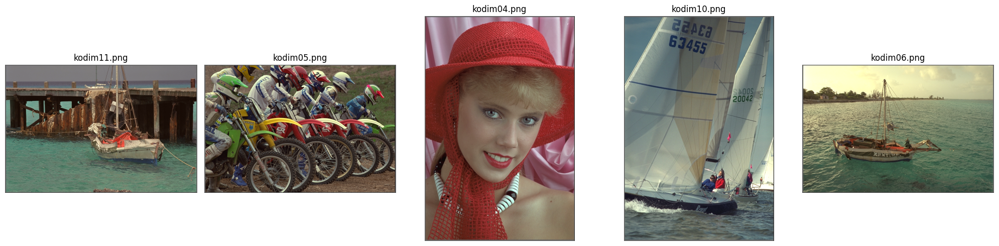

In [4]:
# Specify the directory containing the images
IMAGE_DIR = "./Kodak"
show_images(IMAGE_DIR)

## Linear Algebra Implementation

### Image Compression using SVD

In [5]:
def svd_image_compression(img_np, k):
    """
    Compress an image using Singular Value Decomposition (SVD).

    Parameters:
        img_np (numpy.ndarray): Input image as a NumPy array (H x W x C).
        k (int): Number of singular values to keep for reconstruction.

    Returns:
        numpy.ndarray: Reconstructed image as a NumPy array (H x W x C).
    """
    # Split image into red, green, and blue components
    red, green, blue = img_np[:, :, 0], img_np[:, :, 1], img_np[:, :, 2]

    # Perform SVD on each component
    U_r, S_r, Vt_r = np.linalg.svd(red, full_matrices=False)
    U_g, S_g, Vt_g = np.linalg.svd(green, full_matrices=False)
    U_b, S_b, Vt_b = np.linalg.svd(blue, full_matrices=False)

    # Reconstruct each component using top k singular values
    reconstructed_red = U_r[:, :k] @ np.diag(S_r[:k]) @ Vt_r[:k, :]
    reconstructed_green = U_g[:, :k] @ np.diag(S_g[:k]) @ Vt_g[:k, :]
    reconstructed_blue = U_b[:, :k] @ np.diag(S_b[:k]) @ Vt_b[:k, :]

    # Combine components to make the final reconstructed image
    reconstructed_img = np.stack(
        (reconstructed_red, reconstructed_green, reconstructed_blue), axis=-1
    )
    reconstructed_img = np.clip(reconstructed_img, 0, 255).astype(np.uint8)

    return reconstructed_img

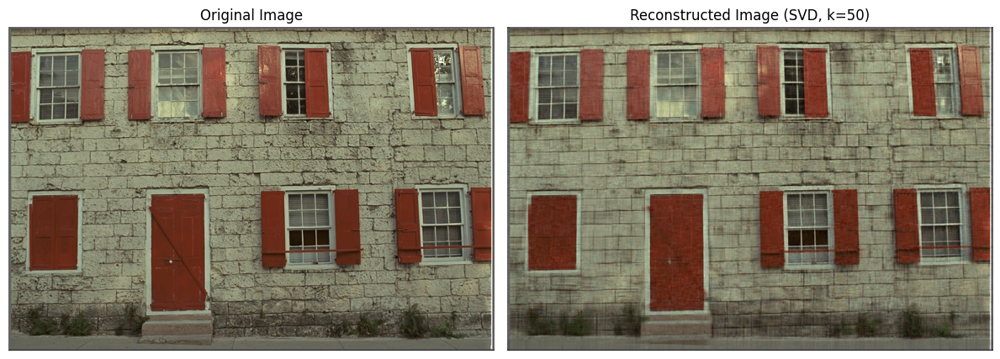

In [6]:
# Load the image
img_path = "./Kodak/kodim01.png"
img = Image.open(img_path).convert("RGB")
img_np = np.array(img).astype(np.float32)

# Number of singular values to keep
k = 50

# Perform SVD compression
reconstructed_img = svd_image_compression(img_np, k)

# Display original and reconstructed images
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(img_np.astype(np.uint8))
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(reconstructed_img)
plt.title(f"Reconstructed Image (SVD, k={k})")
plt.axis("off")

plt.tight_layout()
plt.show()

In [7]:
k = 50  # Number of singular values to keep

# Lists to store results
rec_img_list_svd = []
diff_list_svd = []
psnr_list_svd = []
ssim_list_svd = []
bpp_list_svd = []

# Process each image
image_files_kodak = [f for f in os.listdir(IMAGE_DIR)]
for img_file in image_files_kodak:
    # Load image
    img_path = os.path.join(IMAGE_DIR, img_file)
    img = Image.open(img_path).convert("RGB")
    img_np = np.array(img).astype(np.float32)

    # Compress image using SVD
    reconstructed_img = svd_image_compression(img_np, k)

    # Store reconstructed image
    rec_img_list_svd.append(reconstructed_img)

    # Calculate difference
    diff = reconstructed_img - img_np
    diff_list_svd.append(diff)

    # Calculate metrics
    psnr_list_svd.append(
        compute_psnr(
            torch.tensor(img_np / 255.0), torch.tensor(reconstructed_img / 255.0)
        )
    )
    ssim_list_svd.append(
        compute_msssim(
            torch.tensor(np.expand_dims(img_np.T, axis=0)).float(),
            torch.tensor(np.expand_dims(reconstructed_img.T, axis=0)).float(),
        )
    )
    bpp_list_svd.append(calculate_bpp_svd(img_np.shape[:2], k))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-146.0..108.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-176.0..127.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-152.0..85.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-126.0..122.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-148.0..149.0].


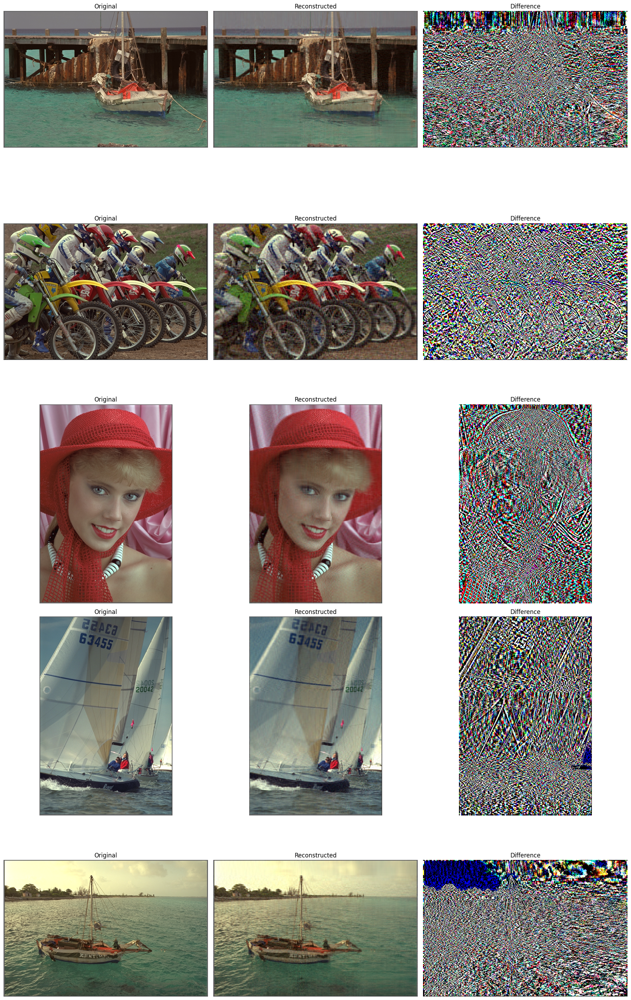

In [8]:
# Get a list of image files in the directory
image_files = [f for f in os.listdir(IMAGE_DIR)]
selected_images_kodak = image_files[:5]
reconstructed_images_kodak = rec_img_list_svd[:5]
diff_images_kodak = diff_list_svd[:5]

# Set up the overall figure
fig, axes = plt.subplots(5, 3, figsize=(18, 30))

for i in range(5):
    # Hide axes for all subplots
    for ax in axes[i]:
        ax.axis("off")

    # Original image
    img_path = os.path.join(IMAGE_DIR, selected_images_kodak[i])
    img = Image.open(img_path)
    axes[i, 0].imshow(img)
    axes[i, 0].title.set_text("Original")

    # Reconstructed image
    axes[i, 1].imshow(reconstructed_images_kodak[i])
    axes[i, 1].title.set_text("Reconstructed")

    # Difference image
    axes[i, 2].imshow(diff_images_kodak[i], cmap="viridis")
    axes[i, 2].title.set_text("Difference")

# Adjust layout
plt.tight_layout()

In [9]:
# Print statistics for SVD method
print(f"PSNR: {np.mean(psnr_list_svd):.4f} dB")
print(f"MS-SSIM: {np.mean(ssim_list_svd):.4f}")
print(f"Bit-rate: {np.mean(bpp_list_svd):.4f} bpp")
metrics["svd"] = {
    "psnr": np.mean(psnr_list_svd),
    "ms-ssim": np.mean(ssim_list_svd),
    "bit-rate": np.mean(bpp_list_svd),
}

PSNR: 27.9959 dB
MS-SSIM: 0.7854
Bit-rate: 15.6372 bpp


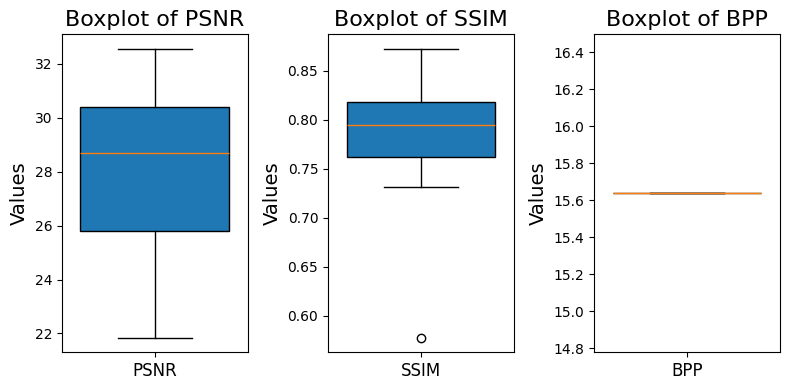

In [10]:
data = [psnr_list_svd, ssim_list_svd, bpp_list_svd]
labels = ["PSNR", "SSIM", "BPP"]

# Create the boxplot
fig, axes = plt.subplots(1, 3, figsize=(8, 4))  # 1 row, 3 columns

# Boxplot for PSNR
axes[0].boxplot(psnr_list_svd, widths=0.8, patch_artist=True)
axes[0].set_title("Boxplot of PSNR", fontsize=16)
axes[0].set_ylabel("Values", fontsize=14)
axes[0].set_xticks([1])
axes[0].set_xticklabels(["PSNR"], fontsize=12)

# Boxplot for SSIM
axes[1].boxplot(ssim_list_svd, widths=0.8, patch_artist=True)
axes[1].set_title("Boxplot of SSIM", fontsize=16)
axes[1].set_ylabel("Values", fontsize=14)
axes[1].set_xticks([1])
axes[1].set_xticklabels(["SSIM"], fontsize=12)

# Boxplot for BPP
axes[2].boxplot(bpp_list_svd, widths=0.8, patch_artist=True)
axes[2].set_title("Boxplot of BPP", fontsize=16)
axes[2].set_ylabel("Values", fontsize=14)
axes[2].set_xticks([1])
axes[2].set_xticklabels(["BPP"], fontsize=12)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

### Image Compression using DCT:

In [11]:
# Define reusable functions for 2D DCT and inverse DCT
def dct2(a):
    """Perform 2D Discrete Cosine Transform."""
    return dct(dct(a.T, norm="ortho").T, norm="ortho")

def idct2(a):
    """Perform 2D Inverse Discrete Cosine Transform."""
    return idct(idct(a.T, norm="ortho").T, norm="ortho")

def process_channel(channel, patch_size, thresh):
    """Apply DCT, thresholding, and inverse DCT on a single channel."""
    dct_transformed = np.zeros_like(channel)
    for i in range(0, channel.shape[0], patch_size):
        for j in range(0, channel.shape[1], patch_size):
            dct_transformed[i:i + patch_size, j:j + patch_size] = dct2(
                channel[i:i + patch_size, j:j + patch_size]
            )
    
    # Threshold the DCT coefficients
    dct_thresh = dct_transformed * (
        np.abs(dct_transformed) > thresh * np.max(np.abs(dct_transformed))
    )
    
    # Reconstruct the channel using inverse DCT
    reconstructed = np.zeros_like(channel)
    for i in range(0, channel.shape[0], patch_size):
        for j in range(0, channel.shape[1], patch_size):
            reconstructed[i:i + patch_size, j:j + patch_size] = idct2(
                dct_thresh[i:i + patch_size, j:j + patch_size]
            )
    
    return dct_thresh, reconstructed

def process_image(img_path, patch_size, thresh):
    """Process an image with DCT-based compression and reconstruction."""
    # Load and convert image to numpy array
    img = Image.open(img_path).convert("RGB")
    img_np = np.array(img).astype(np.float32)
    
    # Split into channels
    red, green, blue = img_np[:, :, 0], img_np[:, :, 1], img_np[:, :, 2]
    
    # Process each channel
    dct_red, reconstructed_red = process_channel(red, patch_size, thresh)
    dct_green, reconstructed_green = process_channel(green, patch_size, thresh)
    dct_blue, reconstructed_blue = process_channel(blue, patch_size, thresh)
    
    # Combine reconstructed channels into final image
    reconstructed_img = np.stack(
        (reconstructed_red, reconstructed_green, reconstructed_blue), axis=-1
    )
    reconstructed_img = np.clip(reconstructed_img, 0, 255).astype(np.uint8)
    
    return img_np, reconstructed_img, dct_red, dct_green, dct_blue

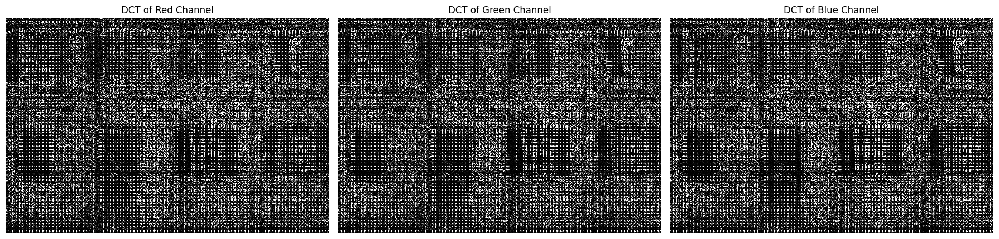

In [12]:
# Load the image
img_path = "./Kodak/kodim01.png"
img = Image.open(img_path).convert("RGB")
img_np = np.array(img).astype(np.float32)

# Split the image into Red, Green, and Blue components
red, green, blue = img_np[:, :, 0], img_np[:, :, 1], img_np[:, :, 2]

# Set patch size for compression
patch_size = 8


# Apply DCT to each channel without reconstruction
def dct_only(channel, patch_size):
    """Apply DCT to each patch of the channel."""
    dct_transformed = np.zeros_like(channel)
    for i in range(0, channel.shape[0], patch_size):
        for j in range(0, channel.shape[1], patch_size):
            dct_transformed[i : i + patch_size, j : j + patch_size] = dct2(
                channel[i : i + patch_size, j : j + patch_size]
            )
    return dct_transformed


# Compute DCT for each channel
img_dct_red = dct_only(red, patch_size)
img_dct_green = dct_only(green, patch_size)
img_dct_blue = dct_only(blue, patch_size)

# Plot each component after DCT is applied
plt.figure(figsize=(18, 10))
plt.subplot(1, 3, 1)
plt.imshow(img_dct_red, cmap="gray", vmin=0, vmax=np.max(img_dct_red) * 0.01)
plt.title("DCT of Red Channel")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(img_dct_green, cmap="gray", vmin=0, vmax=np.max(img_dct_green) * 0.01)
plt.title("DCT of Green Channel")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(img_dct_blue, cmap="gray", vmin=0, vmax=np.max(img_dct_blue) * 0.01)
plt.title("DCT of Blue Channel")
plt.axis("off")

plt.tight_layout()
plt.show()

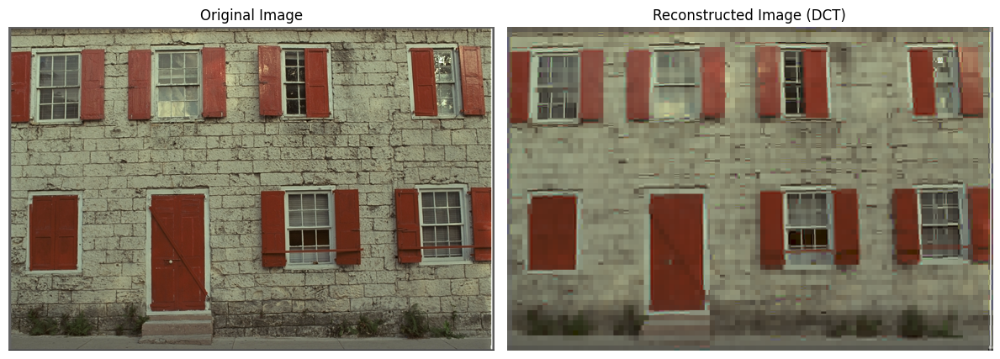

In [13]:
# Load image and convert to RGB format
img_path = "./Kodak/kodim01.png"
img = Image.open(img_path).convert("RGB")

# Set patch size and threshold for compression
patch_size = 8
thresh = 0.1

# Process the image
original_img, reconstructed_img, _, _, _ = process_image(img_path, patch_size, thresh)

# Visualize original and reconstructed images
plt.figure(figsize=(12, 5))

# Show the original image
plt.subplot(1, 2, 1)
plt.imshow(original_img.astype(np.uint8))
plt.title("Original Image")
plt.axis("off")

# Show the reconstructed image
plt.subplot(1, 2, 2)
plt.imshow(reconstructed_img)
plt.title("Reconstructed Image (DCT)")
plt.axis("off")

plt.tight_layout()
plt.show()


In [14]:
image_files_kodak = [f for f in os.listdir(IMAGE_DIR)]

# Parameters
patch_size = 8
thresh = 0.04

# Lists to store results
rec_img_list_dct = []
diff_list_dct = []
psnr_list_dct = []
ssim_list_dct = []
bpp_list_dct = []

# Process each image
for img_file in image_files_kodak:
    img_path = os.path.join(IMAGE_DIR, img_file)
    original_img, reconstructed_img, dct_red, dct_green, dct_blue = process_image(
        img_path, patch_size, thresh
    )
    
    # Store reconstructed image
    rec_img_list_dct.append(reconstructed_img)
    
    # Calculate difference
    diff = reconstructed_img - original_img
    diff_list_dct.append(diff)
    
    # Calculate metrics
    psnr_list_dct.append(
        compute_psnr(
            torch.tensor(original_img / 255.0), torch.tensor(reconstructed_img / 255.0)
        )
    )
    ssim_list_dct.append(
        compute_msssim(
            torch.tensor(np.expand_dims(original_img.T, axis=0)).float(),
            torch.tensor(np.expand_dims(reconstructed_img.T, axis=0)).float(),
        )
    )
    bpp = calculate_bpp_dct(
        original_img.shape, dct_red, dct_green, dct_blue, bit_depth=8
    )
    bpp_list_dct.append(bpp)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-218.0..133.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-183.0..174.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-110.0..101.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-156.0..148.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-168.0..122.0].


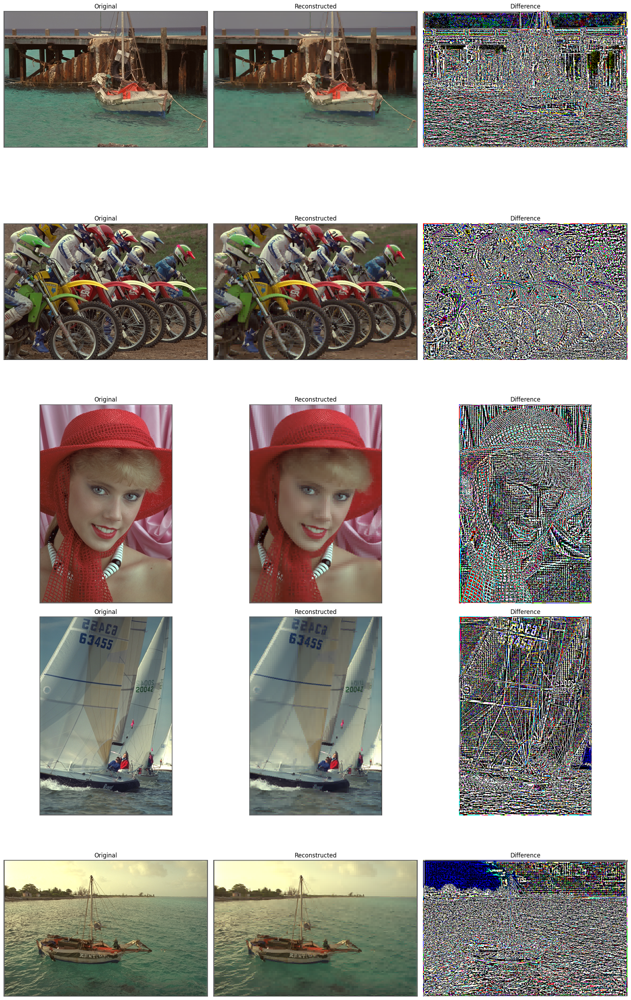

In [15]:
# Get a list of image files in the directory
image_files = [f for f in os.listdir(IMAGE_DIR)]
selected_images_kodak = image_files[:5]
reconstructed_images_kodak = rec_img_list_dct[:5]
diff_images_kodak = diff_list_dct[:5]

# Set up the overall figure
fig, axes = plt.subplots(5, 3, figsize=(18, 30))

for i in range(5):
    # Hide axes for all subplots
    for ax in axes[i]:
        ax.axis("off")

    # Original image
    img_path = os.path.join(IMAGE_DIR, selected_images_kodak[i])
    img = Image.open(img_path)
    axes[i, 0].imshow(img)
    axes[i, 0].title.set_text("Original")

    # Reconstructed image
    axes[i, 1].imshow(reconstructed_images_kodak[i])
    axes[i, 1].title.set_text("Reconstructed")

    # Difference image
    axes[i, 2].imshow(diff_images_kodak[i], cmap="viridis")
    axes[i, 2].title.set_text("Difference")

# Adjust layout
plt.tight_layout()

In [16]:
# Print statistics for DCT method
print(f"PSNR: {np.mean(psnr_list_dct):.4f} dB")
print(f"MS-SSIM: {np.mean(ssim_list_dct):.4f}")
print(f"mbt Bit-rate: {np.mean(bpp_list_dct):.4f} bpp")
metrics["dct"] = {
    "psnr": np.mean(psnr_list_dct),
    "ms-ssim": np.mean(ssim_list_dct),
    "bit-rate": np.mean(bpp_list_dct),
}

PSNR: 27.2296 dB
MS-SSIM: 0.6909
mbt Bit-rate: 0.6705 bpp


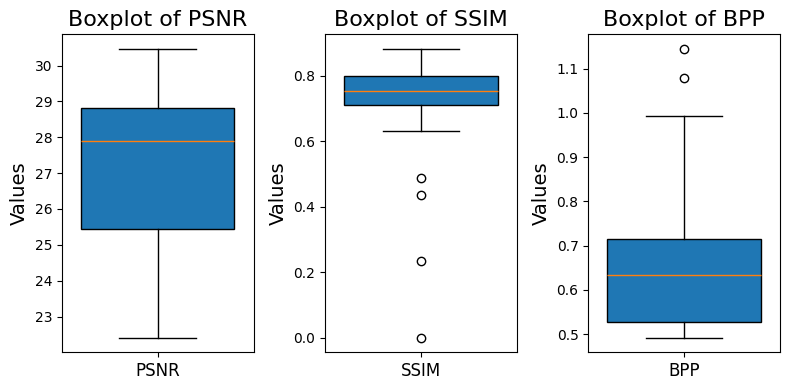

In [17]:
data = [psnr_list_dct, ssim_list_dct, bpp_list_dct]
labels = ["PSNR", "SSIM", "BPP"]

# Create the boxplot
fig, axes = plt.subplots(1, 3, figsize=(8, 4))  # 1 row, 3 columns

# Boxplot for PSNR
axes[0].boxplot(psnr_list_dct, widths=0.8, patch_artist=True)
axes[0].set_title("Boxplot of PSNR", fontsize=16)
axes[0].set_ylabel("Values", fontsize=14)
axes[0].set_xticks([1])
axes[0].set_xticklabels(["PSNR"], fontsize=12)

# Boxplot for SSIM
axes[1].boxplot(ssim_list_dct, widths=0.8, patch_artist=True)
axes[1].set_title("Boxplot of SSIM", fontsize=16)
axes[1].set_ylabel("Values", fontsize=14)
axes[1].set_xticks([1])
axes[1].set_xticklabels(["SSIM"], fontsize=12)

# Boxplot for BPP
axes[2].boxplot(bpp_list_dct, widths=0.8, patch_artist=True)
axes[2].set_title("Boxplot of BPP", fontsize=16)
axes[2].set_ylabel("Values", fontsize=14)
axes[2].set_xticks([1])
axes[2].set_xticklabels(["BPP"], fontsize=12)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

## State-of Art Algorithms

### Algorithm
Based on the article [Variational Image Compression with a Scale Hyperprior](https://arxiv.org/abs/1802.01436) and the article [Joint Autoregressive and Hierarchical Priors for Learned Image Compression](https://arxiv.org/abs/1809.02736).

**Import Pertained Models:**

In [18]:
device = "cuda" if torch.cuda.is_available() else "cpu"
bmshjmodel = bmshj2018_factorized(
    quality=1, metric="mse", pretrained=True, progress=True
)
mbtmodel = mbt2018(quality=1, metric="mse", pretrained=True, progress=True)

In [19]:
# Get a list of image files in the directory
image_files_kodak = [f for f in os.listdir(IMAGE_DIR)]

x_hat_list_bmshj = []
rec_img_list_bmshj = []
diff_list_bmshj = []
x_hat_list_mbt = []
rec_img_list_mbt = []
diff_list_mbt = []

psnr_list_bmshj = []
ssim_list_bmshj = []
bpp_list_bmshj = []
psnr_list_mbt = []
ssim_list_mbt = []
bpp_list_mbt = []

for img in image_files_kodak:
    img_path = os.path.join(IMAGE_DIR, img)
    img = Image.open(img_path).convert("RGB")
    # calculate recustructed x
    x = transforms.ToTensor()(img).unsqueeze(0).to(device)
    with torch.no_grad():
        out_net = bmshjmodel.forward(x)
    out_net["x_hat"].clamp_(0, 1)
    x_hat_list_bmshj.append(out_net["x_hat"])
    # calculate metrics
    psnr_list_bmshj.append(compute_psnr(x, out_net["x_hat"]))
    ssim_list_bmshj.append(compute_msssim(x, out_net["x_hat"]))
    bpp_list_bmshj.append(compute_bpp(out_net))
    # convert x into image
    rec_img = transforms.ToPILImage()(out_net["x_hat"].squeeze().cpu())
    rec_img_list_bmshj.append(rec_img)
    # calculate difference
    diff = torch.mean((out_net["x_hat"] - x).abs(), axis=1).squeeze().cpu()
    diff_list_bmshj.append(diff)

for img in image_files_kodak:
    img_path = os.path.join(IMAGE_DIR, img)
    img = Image.open(img_path).convert("RGB")
    # calculate recustructed x
    x = transforms.ToTensor()(img).unsqueeze(0).to(device)
    with torch.no_grad():
        out_net = mbtmodel.forward(x)
    out_net["x_hat"].clamp_(0, 1)
    x_hat_list_mbt.append(out_net["x_hat"])
    # calculate metrics
    psnr_list_mbt.append(compute_psnr(x, out_net["x_hat"]))
    ssim_list_mbt.append(compute_msssim(x, out_net["x_hat"]))
    bpp_list_mbt.append(compute_bpp(out_net))
    # convert x into image
    rec_img = transforms.ToPILImage()(out_net["x_hat"].squeeze().cpu())
    rec_img_list_mbt.append(rec_img)
    # calculate difference
    diff = torch.mean((out_net["x_hat"] - x).abs(), axis=1).squeeze().cpu()
    diff_list_mbt.append(diff)

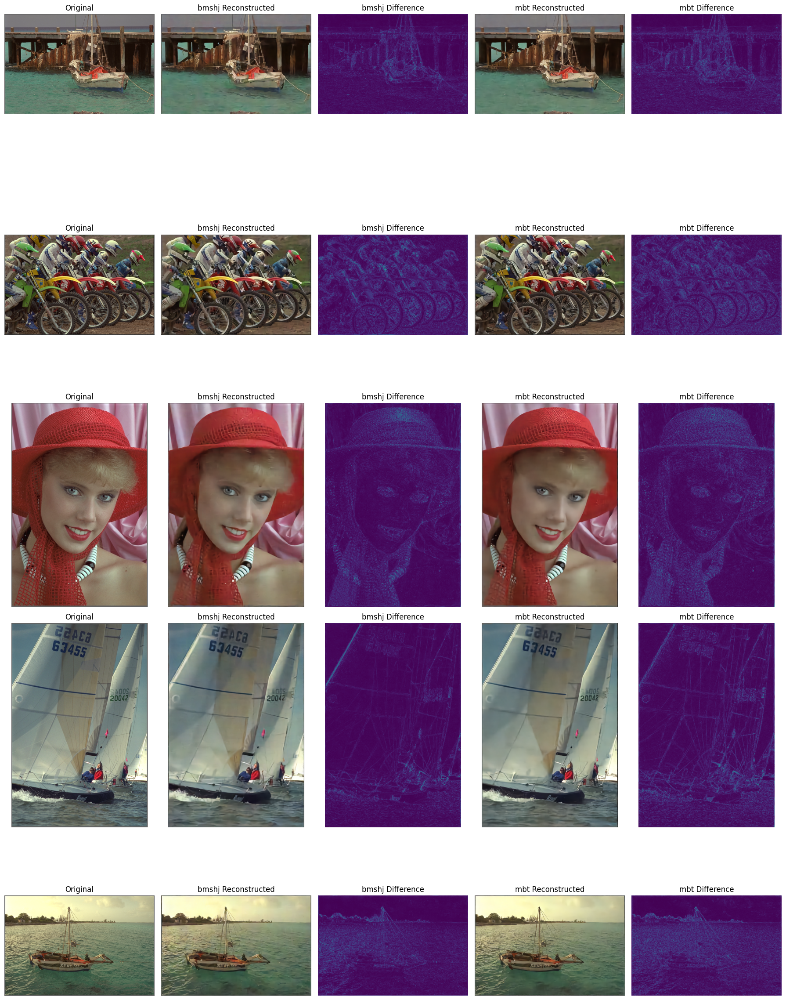

In [20]:
# Get a list of image files in the directory
image_files = [f for f in os.listdir(IMAGE_DIR)]
selected_images_bmsh = image_files[:5]
reconstructed_images_bmshj = rec_img_list_bmshj[:5]
diff_images_bmshj = diff_list_bmshj[:5]

reconstructed_images_mbt = rec_img_list_mbt[:5]
diff_images_mbt = diff_list_mbt[:5]

# Set up the overall figure
fig, axes = plt.subplots(5, 5, figsize=(18, 25))

for i in range(5):
    # Hide axes for all subplots
    for ax in axes[i]:
        ax.axis("off")

    # Original image
    img_path = os.path.join(IMAGE_DIR, selected_images_bmsh[i])
    img = Image.open(img_path)
    axes[i, 0].imshow(img)
    axes[i, 0].title.set_text("Original")

    # Reconstructed image
    axes[i, 1].imshow(reconstructed_images_bmshj[i])
    axes[i, 1].title.set_text("bmshj Reconstructed")

    # Difference image
    axes[i, 2].imshow(diff_images_bmshj[i], cmap="viridis")
    axes[i, 2].title.set_text("bmshj Difference")

    # Reconstructed image
    axes[i, 3].imshow(reconstructed_images_mbt[i])
    axes[i, 3].title.set_text("mbt Reconstructed")

    # Difference image
    axes[i, 4].imshow(diff_images_mbt[i], cmap="viridis")
    axes[i, 4].title.set_text("mbt Difference")

# Adjust layout
plt.tight_layout()

In [21]:
print(f"bmshj PSNR: {np.mean(psnr_list_bmshj):.4f} dB")
print(f"bmshj MS-SSIM: {np.mean(ssim_list_bmshj):.4f}")
print(f"bmshj Bit-rate: {np.mean(bpp_list_bmshj):.4f} bpp")
metrics["SH"] = {
    "psnr": np.mean(psnr_list_bmshj),
    "ms-ssim": np.mean(ssim_list_bmshj),
    "bit-rate": np.mean(bpp_list_bmshj),
}

print(f"mbt PSNR: {np.mean(psnr_list_mbt):.4f} dB")
print(f"mbt MS-SSIM: {np.mean(ssim_list_mbt):.4f}")
print(f"mbt Bit-rate: {np.mean(bpp_list_mbt):.4f} bpp")
metrics["JAHP"] = {
    "psnr": np.mean(psnr_list_mbt),
    "ms-ssim": np.mean(ssim_list_mbt),
    "bit-rate": np.mean(bpp_list_mbt),
}

bmshj PSNR: 27.1239 dB
bmshj MS-SSIM: 0.9158
bmshj Bit-rate: 0.1337 bpp
mbt PSNR: 28.6049 dB
mbt MS-SSIM: 0.9282
mbt Bit-rate: 0.2299 bpp


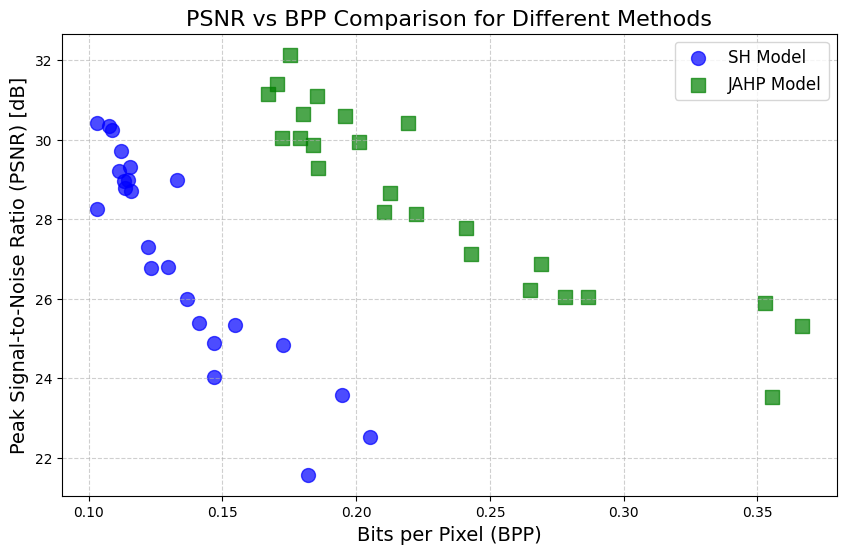

In [22]:
methods = ["SH Model", "JAHP Model"]

# Scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(
    bpp_list_bmshj,
    psnr_list_bmshj,
    color="blue",
    marker="o",
    label="SH Model",
    s=100,
    alpha=0.7,
)
plt.scatter(
    bpp_list_mbt,
    psnr_list_mbt,
    color="green",
    marker="s",
    label="JAHP Model",
    s=100,
    alpha=0.7,
)


# Chart formatting
plt.title("PSNR vs BPP Comparison for Different Methods", fontsize=16)
plt.xlabel("Bits per Pixel (BPP)", fontsize=14)
plt.ylabel("Peak Signal-to-Noise Ratio (PSNR) [dB]", fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, linestyle="--", alpha=0.6)
plt.show()

In [23]:
# Print table to compare statistics of all methods
header = f'{"Model":20s} | {"PSNR [dB]"} | {"MS-SSIM":<9s} | {"Bpp":<9s}|'
print("-" * len(header))
print(header)
print("-" * len(header))
for name, m in metrics.items():
    print(f"{name:20s}", end="")
    for v in m.values():
        print(f" | {v:9.3f}", end="")
    print("|")
print("-" * len(header))

---------------------------------------------------------
Model                | PSNR [dB] | MS-SSIM   | Bpp      |
---------------------------------------------------------
svd                  |    27.996 |     0.785 |    15.637|
dct                  |    27.230 |     0.691 |     0.671|
SH                   |    27.124 |     0.916 |     0.134|
JAHP                 |    28.605 |     0.928 |     0.230|
---------------------------------------------------------


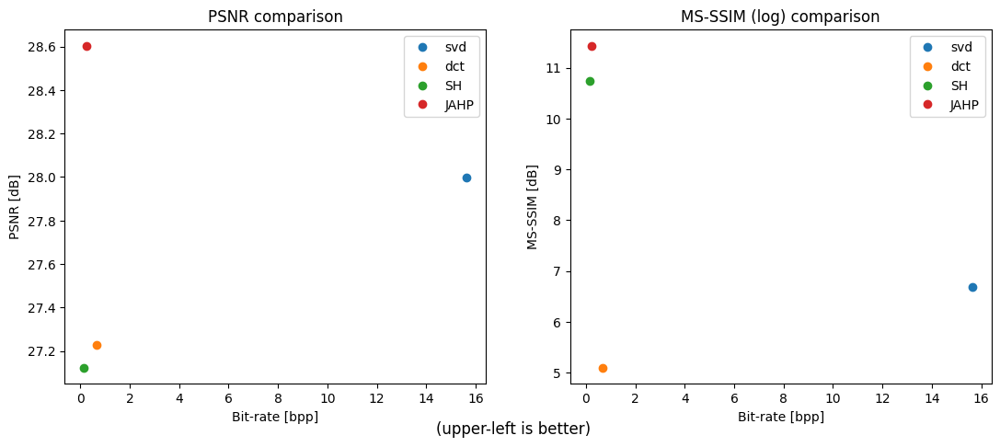

In [24]:
# Plot comparison of each method for PSNR and MS-SSIM
fig, axes = plt.subplots(1, 2, figsize=(13, 5))
plt.figtext(0.5, 0.0, "(upper-left is better)", fontsize=12, ha="center")
for name, m in metrics.items():
    # PSNR Plot
    axes[0].plot(m["bit-rate"], m["psnr"], "o", label=name)
    axes[0].legend(loc="best")
    axes[0].grid()
    axes[0].set_ylabel("PSNR [dB]")
    axes[0].set_xlabel("Bit-rate [bpp]")
    axes[0].title.set_text("PSNR comparison")

    # MS-SSIM Plot
    axes[1].plot(m["bit-rate"], -10 * np.log10(1 - m["ms-ssim"]), "o", label=name)
    axes[1].legend(loc="best")
    axes[1].grid()
    axes[1].set_ylabel("MS-SSIM [dB]")
    axes[1].set_xlabel("Bit-rate [bpp]")
    axes[1].title.set_text("MS-SSIM (log) comparison")

plt.show()